In [2]:
import pandas as pd
import seaborn as sns
sns.set_theme(style="darkgrid")
import matplotlib.pyplot as plt

In [3]:
district_df = pd.read_excel("electric_school_bus_adoption_dataset_v8_2024-08Aug/ESB_adoption_dataset_v8_update_august_2024.xlsx",sheet_name=2)


In [4]:
district_df

,0a. Has committed ESBs?,1a. State,1b. Local Education Agency (LEA) or entity name,1c. LEA ID,1d. Street address 1,1e. Street address 2,1f. City,1g. State,1h. ZIP code,1i. Website,...,5q. WRI Priority Outreach District (POD)?,6a. Has any expression of interest in ESBs?,6b. ARP 2021 waitlist position,6c. DERA school bus rebates 2020 waitlist position,6d. DERA school bus rebates 2021 waitlist position,6e. Applied for ESB funding but not awarded,6f. Member of Climate Mayors Electric Vehicle Purchasing Collaborative?,6g. School district sustainability commitment,6h. District contains Generation180 Solar School?,6i. Participating in Trust for Public Land's Active Community Schoolyard program?
0,no,ALABAMA,Alabama Youth Services,100002,1000 Industrial School Road,NaN,Mt Meigs,AL,36057.0,http://www.dys.alabama.gov/school-district.html,...,False,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,no,ALABAMA,Marshall County,100006,12380 US Highway 431 S,NaN,Guntersville,AL,35976.0,http://www.marshallk12.org,...,False,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,no,ALABAMA,Hoover City,100007,2810 Metropolitan Way,NaN,Hoover,AL,35243.0,http://www.hoovercityschools.net,...,False,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,no,ALABAMA,Madison City,100008,211 Celtic Drive,NaN,Madison,AL,35758.0,http://www.madisoncity.k12.al.us,...,False,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,no,ALABAMA,Al Inst Deaf And Blind,100009,205 E South Street,NaN,Talladega,AL,35160.0,http://www.aidb.org,...,False,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19511,no,WYOMING,Wyoming Department of Family Services,5680251,2300 Capitol Ave,NaN,Cheyenne,WY,82002.0,NaN,...,False,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
19512,no,WYOMING,Youth Emergency Services Inc. - Administration...,5680252,905 N. Gurley Ave,NaN,Gillette,WY,82716.0,http://www.youthemergencyservices.org,...,False,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
19513,no,WYOMING,Wyoming Behavioral Institute - Administration ...,5680253,2521 East 15th Street,NaN,Casper,WY,82609.0,http://wbihelp.com/,...,False,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
19514,no,WYOMING,Rite of Passage,5680255,3304 EI-80 Service Rd,NaN,Cheyenne,WY,82009.0,http://riteofpassage.com/,...,False,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [5]:
district_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19516 entries, 0 to 19515
Data columns (total 91 columns):
 #   Column                                                                              Non-Null Count  Dtype  
---  ------                                                                              --------------  -----  
 0   0a. Has committed ESBs?                                                             19516 non-null  object 
 1   1a. State                                                                           19516 non-null  object 
 2   1b. Local Education Agency (LEA) or entity name                                     19516 non-null  object 
 3   1c. LEA ID                                                                          19516 non-null  object 
 4   1d. Street address 1                                                                19507 non-null  object 
 5   1e. Street address 2                                                                360 non-nul

In [6]:
district_df.describe()['3i. Percent of fleet that is electric']

count    19212.000000
mean         0.016368
std          0.216051
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max         23.000000
Name: 3i. Percent of fleet that is electric, dtype: float64

In [7]:
district_df['3i. Percent of fleet that is electric'].var()


0.04667790755505789

In [8]:
(district_df.isnull().sum()/district_df.shape[0]).round(2)['3i. Percent of fleet that is electric']

0.02

In [9]:
district_df.columns

Index(['0a. Has committed ESBs?', '1a. State',
       '1b. Local Education Agency (LEA) or entity name', '1c. LEA ID',
       '1d. Street address 1', '1e. Street address 2', '1f. City', '1g. State',
       '1h. ZIP code', '1i. Website', '1j. Has LEA ID?',
       '1k. LEA type (number)', '1l. LEA type (name)',
       '1m. Supervisory union LEA ID', '1n. Locale (full number)',
       '1o. Locale broad type (number)', '1p. Locale broad type (name)',
       '1q. Census Region', '1r. Census Division', '1s. Latitude',
       '1t. Longitude ', '2a. Total number of buses',
       '2b. Contractor used for some or all of buses?',
       '3a. Number of ESBs committed ',
       '3b. Number of delivered or operating ESBs',
       '3c. Number of ESBs awarded', '3d. Number of ESBs ordered',
       '3e. Number of ESBs delivered', '3f. Number of ESBs operating',
       '3g. Number of batches', '3h. Size of batch 1', '3h. Size of batch 2',
       '3h. Size of batch 3', '3h. Size of batch 4', '3h. Size o

In [10]:
to_drop_variable = [col for col in district_df.columns if ((district_df.isnull().sum()/district_df.shape[0])>0.9)[col]]
to_drop_variable

['1e. Street address 2',
 '1m. Supervisory union LEA ID',
 '2b. Contractor used for some or all of buses?',
 '3j. Government agency involved (non-funding)',
 '3k. Utility/energy company involved 1',
 '3k. Utility/energy company involved 2',
 '3k. Utility/energy company involved 3',
 '3l. Other groups involved 1',
 '3l. Other groups involved 2',
 '3l. Other groups involved 3',
 '3m. Other notes',
 '6b. ARP 2021 waitlist position',
 '6c. DERA school bus rebates 2020 waitlist position',
 '6d. DERA school bus rebates 2021 waitlist position',
 '6e. Applied for ESB funding but not awarded',
 '6g. School district sustainability commitment',
 "6i. Participating in Trust for Public Land's Active Community Schoolyard program?"]

In [11]:
district_df.drop(to_drop_variable, inplace=True, axis=1)

<Axes: >

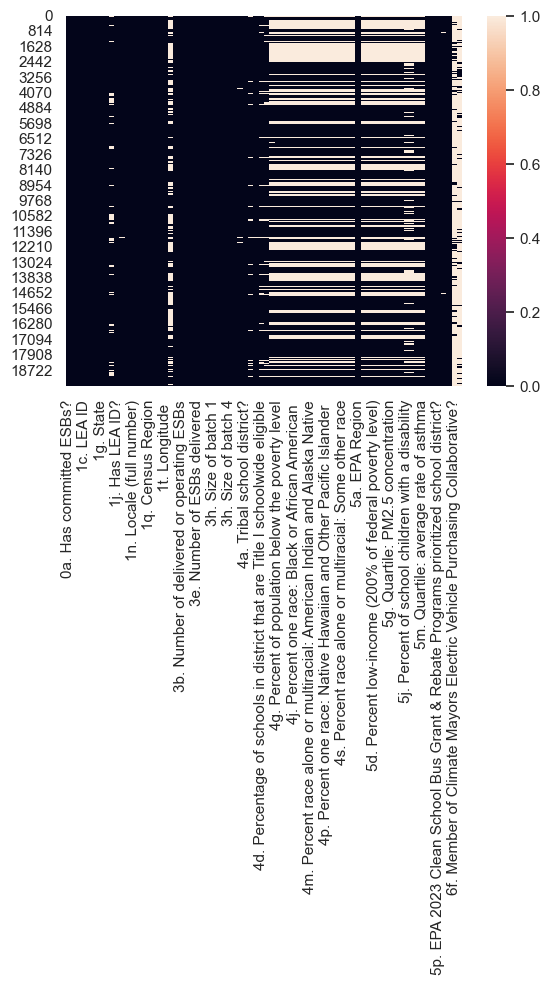

In [12]:
sns.heatmap(district_df.isnull())

In [13]:
any(district_df.duplicated())

False

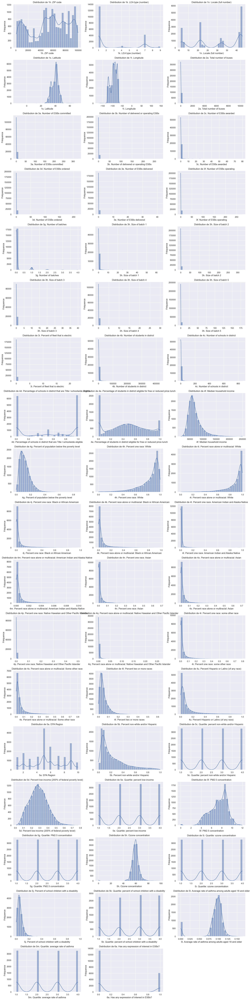

In [14]:
import seaborn as sns
import matplotlib.pyplot as plt

import math
# Affiche la distribution de chaque variable numérique
df_numeric = district_df.select_dtypes(include='number')

# Liste des colonnes numériques
cols = df_numeric.columns
n_cols = 3  # Nombre de colonnes max par ligne
n_rows = math.ceil(len(cols) / n_cols)  # Nombre de lignes nécessaires

fig, axes = plt.subplots(n_rows, n_cols, figsize=(6 * n_cols, 4 * n_rows))
axes = axes.flatten()  # Pour indexer plus facilement

for i, col in enumerate(cols):
    sns.histplot(district_df[col].dropna(), kde=True, bins=30, ax=axes[i])
    axes[i].set_title(f'Distribution de {col}')
    axes[i].set_xlabel(col)
    axes[i].set_ylabel('Fréquence')

# Supprimer les sous-graphiques vides (si le nombre de colonnes n'est pas un multiple de 3)
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()



lat long nomber schools percent fleet

In [15]:
median_val = district_df['4b. Number of students in district'].median()
district_df['4b. Number of students in district'] = district_df['4b. Number of students in district'].fillna(median_val)

In [16]:
df_missing = district_df[district_df["2a. Total number of buses"].isna()]
df_not_missing = district_df[district_df["2a. Total number of buses"].notna()]


In [17]:
from sklearn.ensemble import RandomForestRegressor

X_train = pd.DataFrame(df_not_missing['4b. Number of students in district'])
y_train = df_not_missing["2a. Total number of buses"]

model = RandomForestRegressor()
model.fit(X_train, y_train)


RandomForestRegressor()

In [18]:
X_missing = pd.DataFrame(df_missing['4b. Number of students in district'])
y_pred = model.predict(X_missing)


In [19]:
import numpy as np
import plotly.express as px
import plotly.graph_objects as go

x_range = np.linspace(district_df['4b. Number of students in district'].min(), district_df['4b. Number of students in district'].max(), 1000)
y_range = model.predict(x_range.reshape(-1, 1))

fig = go.Figure([
    go.Scatter(x=X_train.squeeze(), y=y_train, name='train', mode='markers'),
    go.Scatter(x=X_missing.squeeze(), y=y_pred, name='pred', mode='markers'),
    go.Scatter(x=x_range, y=y_range, name='prediction')
])
fig.show()

c:\Users\tanto\anaconda3\Lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


In [20]:
district_df.loc[district_df["2a. Total number of buses"].isna(), "2a. Total number of buses"] = y_pred

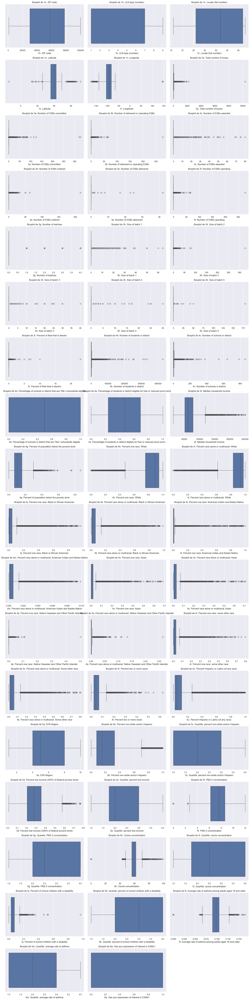

In [21]:
import matplotlib.pyplot as plt
import seaborn as sns
import math

cols = df_numeric.columns
n_cols = 3  # Nombre de colonnes par ligne
n_rows = math.ceil(len(cols) / n_cols)

fig, axes = plt.subplots(n_rows, n_cols, figsize=(6 * n_cols, 4 * n_rows))
axes = axes.flatten()

for i, col in enumerate(cols):
    sns.boxplot(x=district_df[col].dropna(), ax=axes[i], orient='h')
    axes[i].set_title(f'Boxplot de {col}')
    axes[i].set_xlabel(col)

# Supprimer les cases vides si nécessaire
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


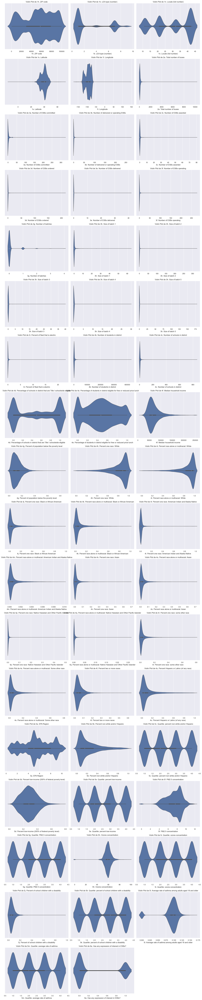

In [22]:

cols = df_numeric.columns
n_cols = 3
n_rows = math.ceil(len(cols) / n_cols)

fig, axes = plt.subplots(n_rows, n_cols, figsize=(6 * n_cols, 5 * n_rows))
axes = axes.flatten()

for i, col in enumerate(cols):
    sns.violinplot(x=district_df[col].dropna(), ax=axes[i], orient='h', inner='box', linewidth=1)
    axes[i].set_title(f'Violin Plot de {col}')
    axes[i].set_xlabel(col)

# Supprimer les sous-graphiques inutilisés
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


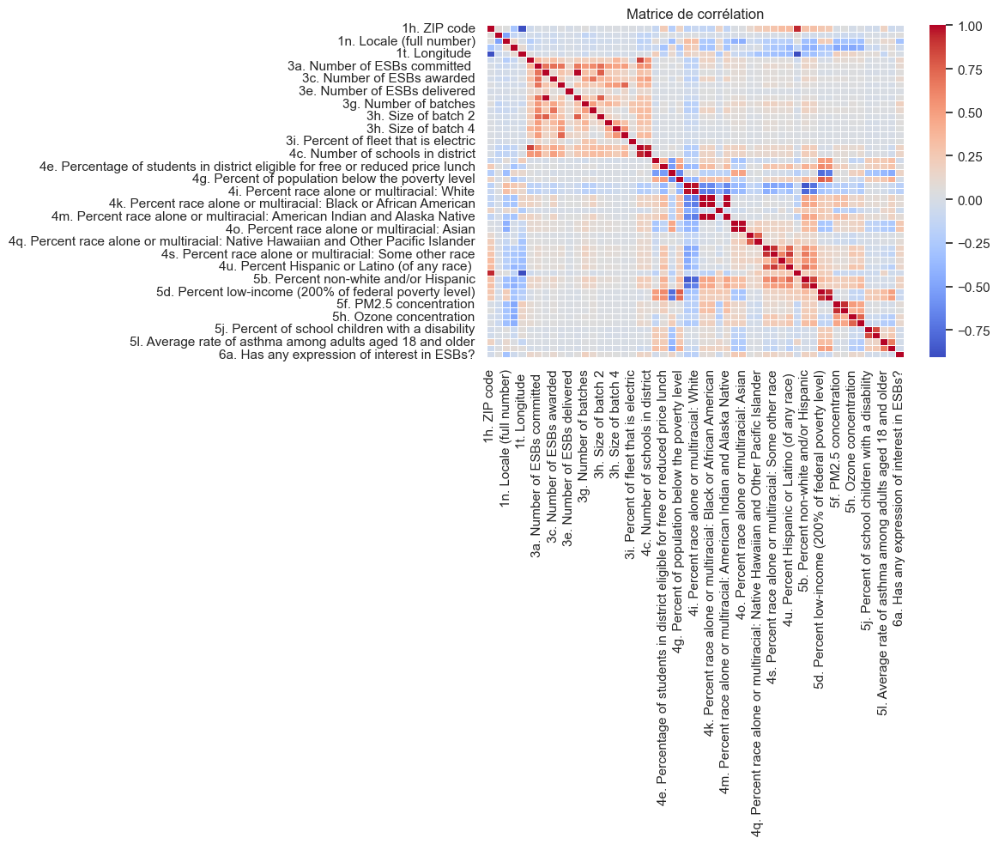

In [ ]:

plt.figure(figsize=(12, 10))
correlation = df_numeric.corr()

sns.heatmap(correlation, annot=False, fmt=".2f", cmap='coolwarm', linewidths=0.5)
plt.title('Matrice de corrélation')
plt.tight_layout()
plt.show()


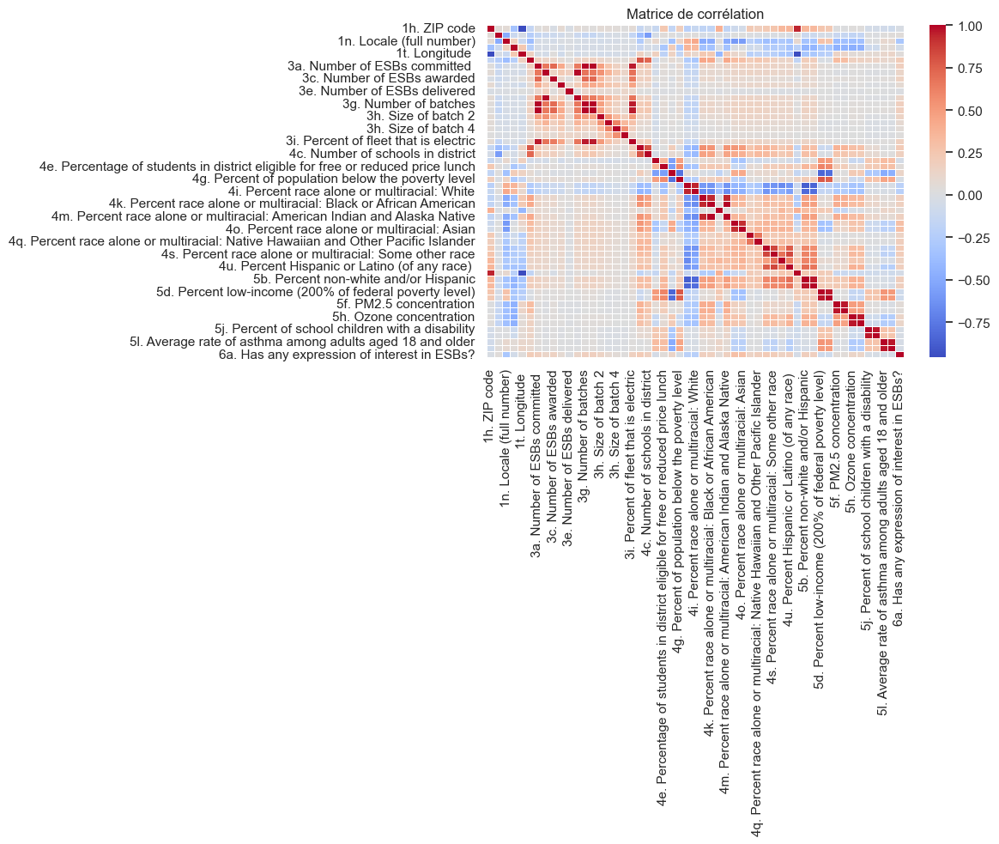

In [58]:
plt.figure(figsize=(12, 10))
sns.heatmap(df_numeric.corr(method='spearman'), annot=False, fmt=".2f", cmap='coolwarm', linewidths=0.5)

plt.title('Matrice de corrélation')
plt.tight_layout()
plt.show()

In [25]:

sns.pairplot(df_numeric, diag_kind="kde", corner=True)


In [26]:
district_df.columns

Index(['0a. Has committed ESBs?', '1a. State',
       '1b. Local Education Agency (LEA) or entity name', '1c. LEA ID',
       '1d. Street address 1', '1f. City', '1g. State', '1h. ZIP code',
       '1i. Website', '1j. Has LEA ID?', '1k. LEA type (number)',
       '1l. LEA type (name)', '1n. Locale (full number)',
       '1o. Locale broad type (number)', '1p. Locale broad type (name)',
       '1q. Census Region', '1r. Census Division', '1s. Latitude',
       '1t. Longitude ', '2a. Total number of buses',
       '3a. Number of ESBs committed ',
       '3b. Number of delivered or operating ESBs',
       '3c. Number of ESBs awarded', '3d. Number of ESBs ordered',
       '3e. Number of ESBs delivered', '3f. Number of ESBs operating',
       '3g. Number of batches', '3h. Size of batch 1', '3h. Size of batch 2',
       '3h. Size of batch 3', '3h. Size of batch 4', '3h. Size of batch 5',
       '3i. Percent of fleet that is electric', '4a. Tribal school district?',
       '4b. Number of studen

<Axes: ylabel='2a. Total number of buses'>

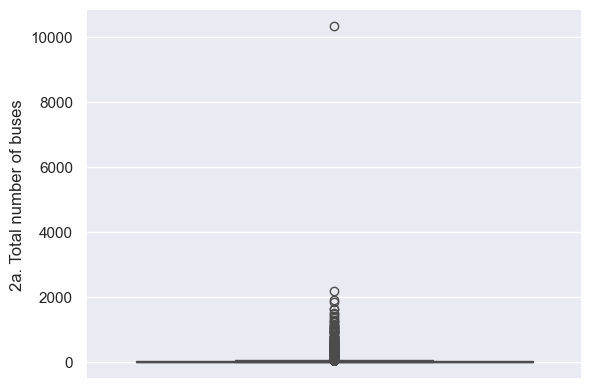

In [27]:
sns.boxplot(district_df["2a. Total number of buses"])

In [28]:
features = [\
       '2a. Total number of buses',
       '3a. Number of ESBs committed ',
       '3c. Number of ESBs awarded', '3d. Number of ESBs ordered',
       '3i. Percent of fleet that is electric', 
       '4b. Number of students in district',
       '4d. Percentage of schools in district that are Title I schoolwide eligible',
       '4e. Percentage of students in district eligible for free or reduced price lunch',
       '4f. Median household income',
       '4g. Percent of population below the poverty level',
       '4h. Percent one race: White ',
       '4i. Percent race alone or multiracial: White',
       '4j. Percent one race: Black or African American ',
       '4k. Percent race alone or multiracial: Black or African American',
       '4l. Percent one race: American Indian and Alaska Native ',
       '4m. Percent race alone or multiracial: American Indian and Alaska Native',
       '4n. Percent one race: Asian ',
       '4o. Percent race alone or multiracial: Asian',
       '4p. Percent one race: Native Hawaiian and Other Pacific Islander ',
       '4q. Percent race alone or multiracial: Native Hawaiian and Other Pacific Islander',
       '4r. Percent one race: some other race ',
       '4s. Percent race alone or multiracial: Some other race',
       '4t. Percent two or more races',
       '4u. Percent Hispanic or Latino (of any race) ', 
       '5b. Percent non-white and/or Hispanic',
       '5d. Percent low-income (200% of federal poverty level)',
  '5f. PM2.5 concentration',
        '5h. Ozone concentration',
       '5j. Percent of school children with a disability',
       '5l. Average rate of asthma among adults aged 18 and older',
       '5o. EPA 2022 Clean School Bus Rebate Program prioritized school district?',
       '5p. EPA 2023 Clean School Bus Grant & Rebate Programs prioritized school district?',
       '6a. Has any expression of interest in ESBs?',
]

In [29]:
def percent_distribution(variable):
    return (district_df[variable].value_counts())/len(district_df[variable])

In [30]:
(district_df['4a. Tribal school district?'].value_counts())/len(district_df['4a. Tribal school district?'])

4a. Tribal school district?
No     0.991084
Yes    0.008916
Name: count, dtype: float64

In [31]:
(district_df['5n. Qualified for American Rescue Plan funding? '].value_counts())/len(district_df['5n. Qualified for American Rescue Plan funding? '])

5n. Qualified for American Rescue Plan funding? 
No     0.951424
Yes    0.048576
Name: count, dtype: float64

In [32]:
percent_distribution('5p. EPA 2023 Clean School Bus Grant & Rebate Programs prioritized school district?')

5p. EPA 2023 Clean School Bus Grant & Rebate Programs prioritized school district?
No     0.717155
Yes    0.282845
Name: count, dtype: float64

In [33]:
percent_distribution('5o. EPA 2022 Clean School Bus Rebate Program prioritized school district?')

5o. EPA 2022 Clean School Bus Rebate Program prioritized school district?
No     0.612113
Yes    0.387631
yes    0.000256
Name: count, dtype: float64

In [34]:
percent_distribution('5q. WRI Priority Outreach District (POD)?')

5q. WRI Priority Outreach District (POD)?
False      0.914532
True       0.077270
Unknown    0.001537
Name: count, dtype: float64

In [35]:
percent_distribution('6a. Has any expression of interest in ESBs?')

6a. Has any expression of interest in ESBs?
0.0    0.684054
1.0    0.314767
Name: count, dtype: float64

In [36]:
percent_distribution('6f. Member of Climate Mayors Electric Vehicle Purchasing Collaborative?')

6f. Member of Climate Mayors Electric Vehicle Purchasing Collaborative?
yes (city)                                  0.092847
yes (county)                                0.033818
yes (Port Authority of Allegheny County)    0.003945
yes (transit)                               0.003279
yes (university)                            0.000820
yes (school)                                0.000102
Name: count, dtype: float64

In [37]:
percent_distribution('6h. District contains Generation180 Solar School?')

6h. District contains Generation180 Solar School?
yes    0.125128
Name: count, dtype: float64

In [38]:
percent_distribution('5a. EPA Region')

5a. EPA Region
5     0.230170
9     0.148852
6     0.129381
2     0.093359
7     0.077987
4     0.073529
8     0.071787
1     0.070916
3     0.062103
10    0.041914
Name: count, dtype: float64

In [39]:
features

['2a. Total number of buses',
 '3a. Number of ESBs committed ',
 '3c. Number of ESBs awarded',
 '3d. Number of ESBs ordered',
 '3i. Percent of fleet that is electric',
 '4b. Number of students in district',
 '4d. Percentage of schools in district that are Title I schoolwide eligible',
 '4e. Percentage of students in district eligible for free or reduced price lunch',
 '4f. Median household income',
 '4g. Percent of population below the poverty level',
 '4h. Percent one race: White ',
 '4i. Percent race alone or multiracial: White',
 '4j. Percent one race: Black or African American ',
 '4k. Percent race alone or multiracial: Black or African American',
 '4l. Percent one race: American Indian and Alaska Native ',
 '4m. Percent race alone or multiracial: American Indian and Alaska Native',
 '4n. Percent one race: Asian ',
 '4o. Percent race alone or multiracial: Asian',
 '4p. Percent one race: Native Hawaiian and Other Pacific Islander ',
 '4q. Percent race alone or multiracial: Native Ha

In [40]:
features_df = district_df[features]

In [41]:
features_df.isnull().sum()/features_df.shape[0]

2a. Total number of buses                                                             0.000000
3a. Number of ESBs committed                                                          0.000000
3c. Number of ESBs awarded                                                            0.000000
3d. Number of ESBs ordered                                                            0.000000
3i. Percent of fleet that is electric                                                 0.015577
4b. Number of students in district                                                    0.000000
4d. Percentage of schools in district that are Title I schoolwide eligible            0.060873
4e. Percentage of students in district eligible for free or reduced price lunch       0.076706
4f. Median household income                                                           0.333163
4g. Percent of population below the poverty level                                     0.330139
4h. Percent one race: White                       

In [42]:
# 4h. Percent one race: White          4i. Percent race alone or multiracial: White  

In [43]:
features_df[features_df["4k. Percent race alone or multiracial: Black or African American"].isnull()]["4i. Percent race alone or multiracial: White"].unique()

array([nan])

In [44]:
district_df['5o. EPA 2022 Clean School Bus Rebate Program prioritized school district?'] = district_df['5o. EPA 2022 Clean School Bus Rebate Program prioritized school district?'].replace("No",0)

In [45]:
district_df['5o. EPA 2022 Clean School Bus Rebate Program prioritized school district?'] = district_df['5o. EPA 2022 Clean School Bus Rebate Program prioritized school district?'].replace("yes",1)

In [46]:
district_df['5o. EPA 2022 Clean School Bus Rebate Program prioritized school district?'] = district_df['5o. EPA 2022 Clean School Bus Rebate Program prioritized school district?'].replace("Yes",1)

C:\Users\tanto\AppData\Local\Temp\ipykernel_21568\1549537529.py:1: FutureWarning:

Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`



In [47]:
district_df['5p. EPA 2023 Clean School Bus Grant & Rebate Programs prioritized school district?'] = district_df['5p. EPA 2023 Clean School Bus Grant & Rebate Programs prioritized school district?'].replace("Yes",1)

In [48]:
district_df['5p. EPA 2023 Clean School Bus Grant & Rebate Programs prioritized school district?'] = district_df['5p. EPA 2023 Clean School Bus Grant & Rebate Programs prioritized school district?'].replace("No",0)

C:\Users\tanto\AppData\Local\Temp\ipykernel_21568\3105306984.py:1: FutureWarning:

Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`



<Axes: >

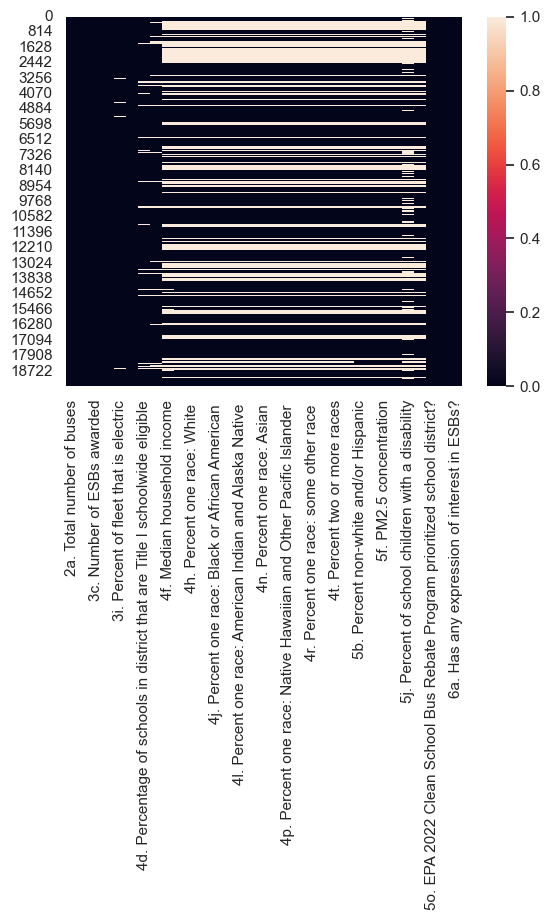

In [49]:
sns.heatmap(features_df.isnull())

In [50]:
features_df.iloc[2000,:]

2a. Total number of buses                                                                  3.0
3a. Number of ESBs committed                                                                 0
3c. Number of ESBs awarded                                                                   0
3d. Number of ESBs ordered                                                                   0
3i. Percent of fleet that is electric                                                      0.0
4b. Number of students in district                                                       557.0
4d. Percentage of schools in district that are Title I schoolwide eligible                 0.0
4e. Percentage of students in district eligible for free or reduced price lunch       0.829443
4f. Median household income                                                                NaN
4g. Percent of population below the poverty level                                          NaN
4h. Percent one race: White                       

In [51]:
drop_rows = [row for row in features_df.index if ((features_df.iloc[row].isnull().sum()/features_df.iloc[1].shape[0])>0.6)]


In [52]:
drop_rows

[0,
 4,
 5,
 9,
 15,
 23,
 24,
 25,
 26,
 27,
 28,
 29,
 31,
 32,
 33,
 142,
 143,
 144,
 145,
 161,
 211,
 216,
 217,
 218,
 219,
 224,
 225,
 226,
 227,
 228,
 229,
 230,
 231,
 232,
 233,
 234,
 235,
 236,
 237,
 238,
 239,
 240,
 241,
 242,
 243,
 244,
 245,
 246,
 247,
 248,
 249,
 250,
 252,
 253,
 254,
 255,
 256,
 257,
 258,
 259,
 260,
 261,
 262,
 263,
 264,
 265,
 266,
 267,
 268,
 269,
 270,
 271,
 272,
 273,
 274,
 275,
 276,
 277,
 278,
 279,
 280,
 281,
 282,
 283,
 284,
 285,
 286,
 287,
 288,
 289,
 290,
 291,
 292,
 293,
 294,
 295,
 296,
 297,
 298,
 299,
 300,
 301,
 302,
 303,
 304,
 305,
 306,
 307,
 309,
 310,
 311,
 312,
 313,
 314,
 315,
 316,
 317,
 318,
 319,
 320,
 321,
 322,
 323,
 324,
 325,
 326,
 327,
 328,
 329,
 330,
 331,
 332,
 333,
 334,
 335,
 336,
 337,
 338,
 339,
 340,
 341,
 342,
 343,
 344,
 345,
 346,
 347,
 348,
 349,
 350,
 352,
 353,
 354,
 355,
 356,
 357,
 358,
 359,
 360,
 361,
 362,
 363,
 364,
 365,
 366,
 367,
 368,
 369,
 370,
 371,

In [54]:
[features_df.iloc[row,:] for row in features_df.index if ((features_df.iloc[row].isnull().sum()/features_df.iloc[1].shape[0])>0.6)]

[2a. Total number of buses                                                             212.019029
 3a. Number of ESBs committed                                                                   0
 3c. Number of ESBs awarded                                                                     0
 3d. Number of ESBs ordered                                                                     0
 3i. Percent of fleet that is electric                                                        0.0
 4b. Number of students in district                                                         702.0
 4d. Percentage of schools in district that are Title I schoolwide eligible                   NaN
 4e. Percentage of students in district eligible for free or reduced price lunch              NaN
 4f. Median household income                                                                  NaN
 4g. Percent of population below the poverty level                                            NaN
 4h. Percent one rac

In [55]:
features_df.drop(index=drop_rows, inplace=True, axis=0)

C:\Users\tanto\AppData\Local\Temp\ipykernel_21568\3299852632.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [56]:
len(features_df)

13184

In [ ]:
# from sklearn.preprocessing import StandardScaler

# X = df.select_dtypes(include='number')  # ou colonnes choisies
# scaler = StandardScaler()
# X_scaled = scaler.fit_transform(X)
# from sklearn.decomposition import PCA
# import matplotlib.pyplot as plt

# pca = PCA(n_components=2)
# X_pca = pca.fit_transform(features_df)

# plt.scatter(X_pca[:, 0], X_pca[:, 1])
# plt.title("Projection PCA")
# plt.xlabel("PC1")
# plt.ylabel("PC2")
# plt.show()


ValueError: Input X contains NaN.
PCA does not accept missing values encoded as NaN natively. For supervised learning, you might want to consider sklearn.ensemble.HistGradientBoostingClassifier and Regressor which accept missing values encoded as NaNs natively. Alternatively, it is possible to preprocess the data, for instance by using an imputer transformer in a pipeline or drop samples with missing values. See https://scikit-learn.org/stable/modules/impute.html You can find a list of all estimators that handle NaN values at the following page: https://scikit-learn.org/stable/modules/impute.html#estimators-that-handle-nan-values